<a href="https://colab.research.google.com/github/ShaleBale/SeaIce/blob/main/sea_ice_test_FINAL_SAM.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
pip install rasterio

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 20.0/20.0 MB 53.7 MB/s eta 0:00:00


In [ ]:
import rasterio

In [ ]:
pip install descartes

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import os
import time
import random
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from tqdm import tqdm, trange
import cv2

from skimage.io import imread, imshow, concatenate_images
from skimage.transform import resize
from skimage.morphology import label, binary_dilation, binary_erosion, reconstruction
from skimage.measure import regionprops, regionprops_table
from skimage import measure
from skimage.segmentation import watershed

from shapely.geometry import Polygon, LineString
from shapely.affinity import scale
from descartes import PolygonPatch

import scipy.ndimage as ndi
import scipy.interpolate

import tensorflow as tf

from tensorflow.keras.models import Model, load_model
from tensorflow.keras.layers import Input, BatchNormalization, Activation, Dense, Dropout
from tensorflow.keras.layers import Lambda, RepeatVector, Reshape
from tensorflow.keras.layers import Conv2D, Conv2DTranspose
from tensorflow.keras.layers import MaxPooling2D
from tensorflow.keras.layers import concatenate, add
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.preprocessing.image import load_img

from glob import glob

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


Using open cv - cv.imshow does not work in colab, must use google patch with cv2_imshow. We load the image with GDAL to maintain georeference capabilities.

In [79]:
img_path = '/content/gdrive/MyDrive/SeaIce/0723_FL0_SC_p10/UF168_145337_168_UL006_144821_RGBN.tif'
mask_path = '/content/gdrive/MyDrive/SeaIce/test_mask_paint.png'

In [80]:
img = cv2.imread(img_path, cv2.IMREAD_LOAD_GDAL)
mask = cv2.imread(mask_path, cv2.IMREAD_LOAD_GDAL)

In [81]:
from google.colab.patches import cv2_imshow


Open CV defaults to reading a BGR image, therefore the displayed image of our ice is defaulted to the first three channels (band 1, band 2, and band 3).

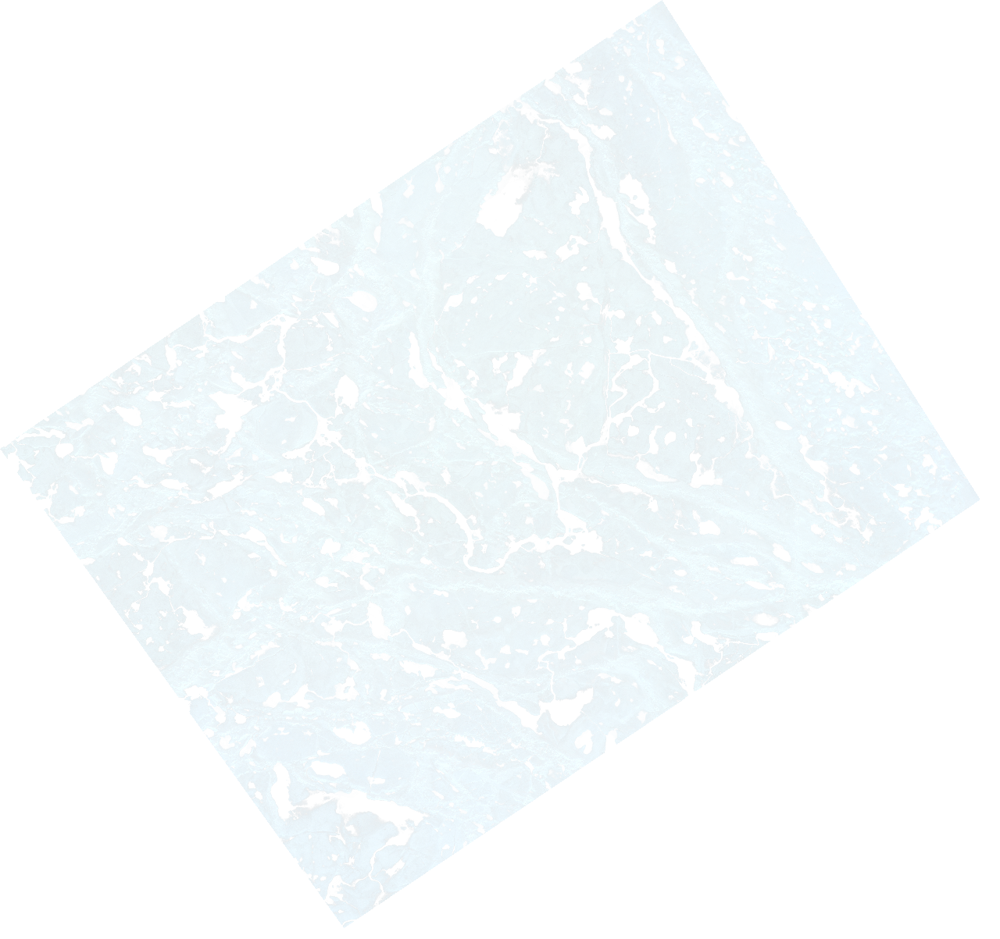

In [82]:
cv2_imshow(img)

We can see that our array shape includes 4 channels, where the fourth band represents the NIR.

In [83]:
img.shape

(1203, 1280, 4)

We now try to load the mask raster.

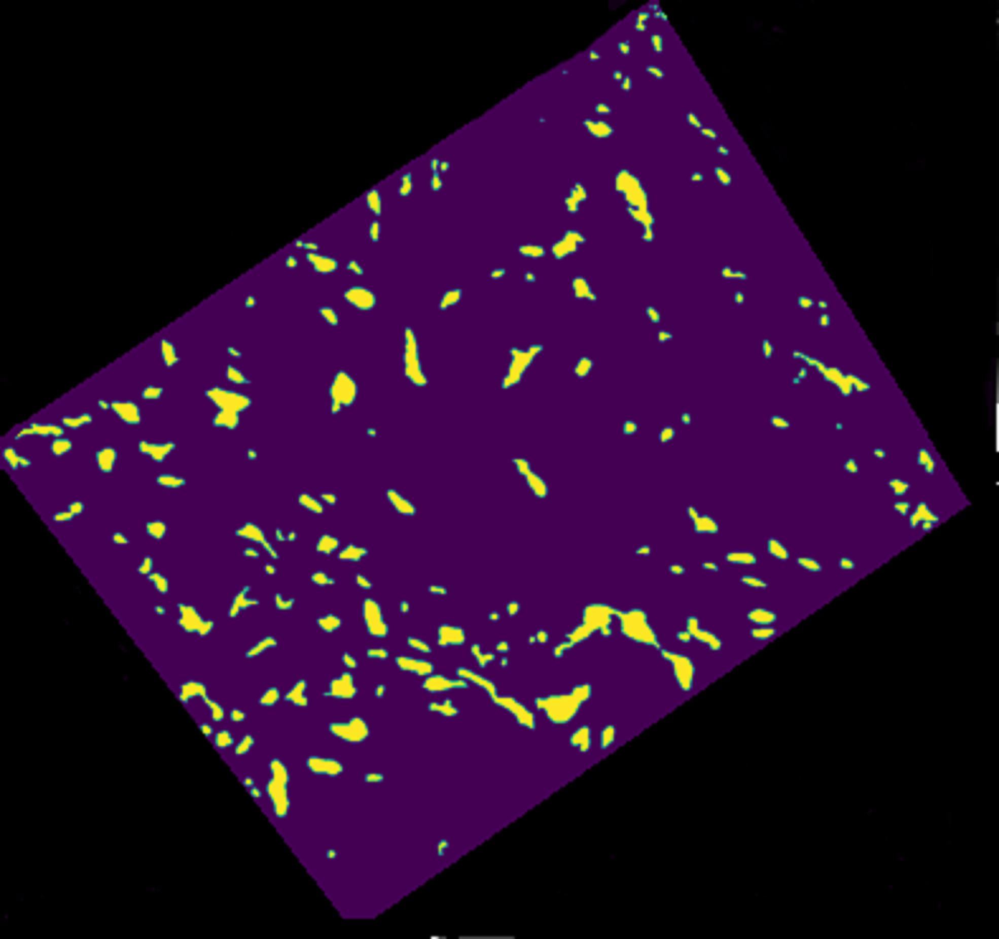

In [84]:
cv2_imshow(mask)

In [85]:
mask.shape

(1850, 1970, 3)

In [86]:
img.shape

(1203, 1280, 4)

We see that the mask shape is much larger than the image shape. This is because the mask was originally generated on a full size tiff of the image, however, for modeling puposes we are using a p10 version of this image to conserve computational resources. The mask must be resized first to match our p10 image size.

In [87]:
!pip install pillow

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [88]:
mask_resize = cv2.resize(mask, (1280,1203), interpolation = cv2.INTER_NEAREST)

In [89]:
mask_resize1.shape

(1203, 1280, 4)

In [90]:
img.shape

(1203, 1280, 4)

In [91]:
np.unique(mask_resize1)

array([  1,   2,   3,   5,   6,   8,   9,  11,  12,  14,  15,  17,  18,
        20,  21,  22,  24,  25,  26,  27,  28,  29,  30,  31,  32,  33,
        34,  35,  36,  37,  38,  39,  40,  41,  42,  43,  44,  45,  46,
        47,  48,  49,  50,  51,  52,  53,  54,  55,  56,  57,  58,  59,
        60,  61,  62,  63,  64,  65,  66,  67,  68,  69,  70,  71,  72,
        73,  74,  75,  76,  77,  78,  79,  80,  81,  82,  83,  84,  85,
        86,  87,  88,  89,  90,  91,  92,  93,  94,  95,  96,  97,  98,
        99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111,
       112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124,
       125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137,
       138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150,
       151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163,
       164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176,
       177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 18

In [97]:
first_band= mask_resize1[:,:,0]

In [98]:
np.unique(first_band)

array([ 24,  25,  26,  27,  28,  29,  30,  31,  33,  34,  36,  38,  39,
        41,  43,  44,  46,  48,  50,  51,  53,  55,  56,  58,  60,  62,
        63,  65,  67,  68,  70,  71,  73,  75,  76,  78,  79,  81,  82,
        84,  85,  86,  87,  88,  89,  90,  91,  92,  93,  94,  95,  96,
        97,  98,  99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109,
       110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122,
       123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135,
       136, 137, 138, 139, 140, 141, 142, 255], dtype=uint8)

In [100]:

unique_values, value_counts = np.unique(first_band, return_counts=True)

# Sort the values based on frequencies in descending order
sorted_indices = np.argsort(value_counts)[::-1]
top_four_values = unique_values[sorted_indices[:4]]

# Print the three most prevalent values
print(top_four_values)

[255  84  36 141]


We create a 3 channel grey mask in cv2 by setting all nodata values to 0, ice values to 100, and pond values to 255.

In [124]:
grey_mask = mask_resize.copy()

# Set all other values to the nearest value in indices_to_keep
indices_to_keep = np.array([0, 255, 141, 84, 36], dtype=np.uint8)

# Flatten both grey_mask and indices_to_keep arrays
grey_mask_flat = grey_mask.flatten()
indices_to_keep_flat = indices_to_keep.flatten()

# Find the nearest value for each value not in indices_to_keep
nearest_values = indices_to_keep_flat[np.argmin(cdist(grey_mask_flat[:, np.newaxis], indices_to_keep_flat[:, np.newaxis]), axis=1)]

# Set values not in indices_to_keep to the nearest values
grey_mask_flat[~np.isin(grey_mask_flat, indices_to_keep_flat)] = nearest_values[~np.isin(grey_mask_flat, indices_to_keep_flat)]

# Reshape grey_mask_flat back to the original shape
grey_mask = grey_mask_flat.reshape(grey_mask.shape)

In [125]:
# Set specific values to desired values
grey_mask[grey_mask == 255] = 0  # no data
grey_mask[grey_mask == 141] = 255  # ponds
grey_mask[grey_mask == 84] = 255  # ponds
grey_mask[grey_mask == 36] = 100  # ice

In [126]:
np.unique(grey_mask)

array([  0, 100, 255], dtype=uint8)

In [127]:
grey_mask.shape

(1203, 1280, 3)

In [128]:
grey_3_channel_mask = cv2.cvtColor(grey_mask[:,:,0], cv2.COLOR_GRAY2BGR)

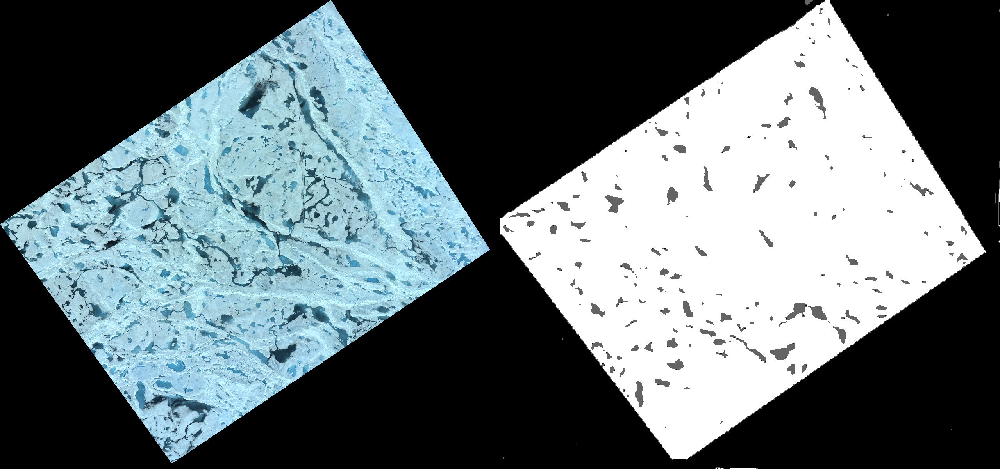

In [129]:
horizontal = np.hstack((img[:,:,0:3], grey_3_channel_mask))
cv2_imshow(horizontal)

In [130]:
def plot_images_and_labels(img, label):
  fig = plt.figure(figsize = (12, 4))
  
  ax1 = fig.add_subplot(131)
  ax1.imshow(img[:,:])
  ax1.set_title("Sea Ice")
  ax1.set_xticks([])
  ax1.set_yticks([])
  
  ax2 = fig.add_subplot(132)
  ax2.imshow(label[:,:])
  ax2.set_title("Label")
  ax2.set_xticks([])
  ax2.set_yticks([])
  
  dst = cv2.addWeighted(img, 0.5, label, 0.5, 0)
  
  ax3 = fig.add_subplot(133)
  ax3.imshow(dst[:,:])
  ax3.set_title("Blending")
  ax3.set_xticks([])
  ax3.set_yticks([])

We look to see how the blended image of the Sea Ice (using the first three channels) and the three-channel gray image blend.

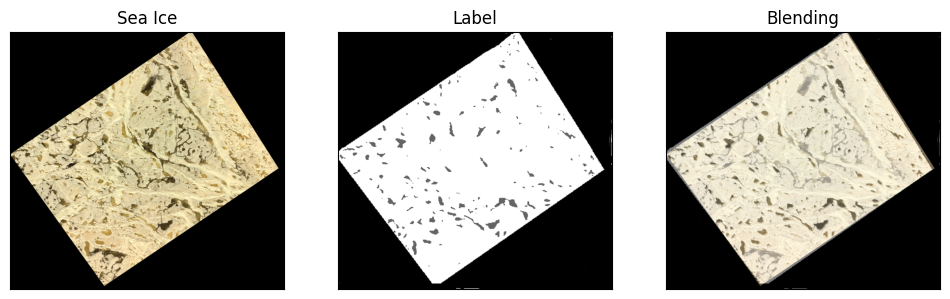

In [131]:
plot_images_and_labels(img[:,:, 0:3], grey_3_channel_mask)

We only have one image and one mask, so to improve results we tile the image to generate more training data.

In [132]:
!mkdir Tiles

In [133]:
cd Tiles

/content/Tiles


In [134]:
!mkdir images
!mkdir labels

In [135]:
cd ..

/content


In [136]:
ls

gdrive/  sample_data/  Tiles/


In [137]:
# break up large images into small squares:
start_no = 0
im_size = 256

# if len(np.shape(img))==3:
#   image = img[:,:,0]
# if len(np.shape(grey_3_channel_mask))==3:
#   lab = grey_3_channel_mask[:,:,0]

r, c, z = np.shape(img)
n_rows = int(np.floor(r/float(im_size)))
n_cols = int(np.floor(c/float(im_size)))


# write files for segmented images:
for i in trange(n_rows):
    for j in range(n_cols):
        im = img[i*im_size:(i+1)*im_size, j*im_size:(j+1)*im_size, :].astype('uint8')
        imname = 'Tiles/images/' + 'im%03d.png'%(start_no+n_cols*i+j)
        m = grey_3_channel_mask[i*im_size:(i+1)*im_size, j*im_size:(j+1)*im_size].astype('uint8')
        labname = 'Tiles/labels/' + 'im%03d.png'%(start_no+n_cols*i+j)
        
        # if np.max(m)>0: # only save images that have more than just background
        im = Image.fromarray(im.astype(np.uint8))
        im.save(imname)
        m = Image.fromarray(m.astype(np.uint8))
        m.save(labname)

start_no = start_no + n_rows*n_cols

100%|██████████| 4/4 [00:00<00:00, 11.88it/s]


In [138]:
from glob import glob
images = sorted(glob("Tiles/images/*.png"))
labels = sorted(glob("Tiles/labels/*.png")) 

In [139]:
for i in range(len(images)):
  print('img_tile: {} | label_tile: {}'.format(images[i], labels[i]))

img_tile: Tiles/images/im000.png | label_tile: Tiles/labels/im000.png
img_tile: Tiles/images/im001.png | label_tile: Tiles/labels/im001.png
img_tile: Tiles/images/im002.png | label_tile: Tiles/labels/im002.png
img_tile: Tiles/images/im003.png | label_tile: Tiles/labels/im003.png
img_tile: Tiles/images/im004.png | label_tile: Tiles/labels/im004.png
img_tile: Tiles/images/im005.png | label_tile: Tiles/labels/im005.png
img_tile: Tiles/images/im006.png | label_tile: Tiles/labels/im006.png
img_tile: Tiles/images/im007.png | label_tile: Tiles/labels/im007.png
img_tile: Tiles/images/im008.png | label_tile: Tiles/labels/im008.png
img_tile: Tiles/images/im009.png | label_tile: Tiles/labels/im009.png
img_tile: Tiles/images/im010.png | label_tile: Tiles/labels/im010.png
img_tile: Tiles/images/im011.png | label_tile: Tiles/labels/im011.png
img_tile: Tiles/images/im012.png | label_tile: Tiles/labels/im012.png
img_tile: Tiles/images/im013.png | label_tile: Tiles/labels/im013.png
img_tile: Tiles/imag

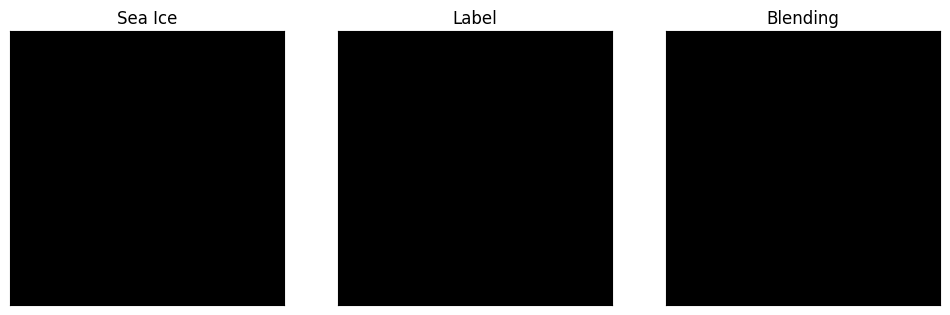

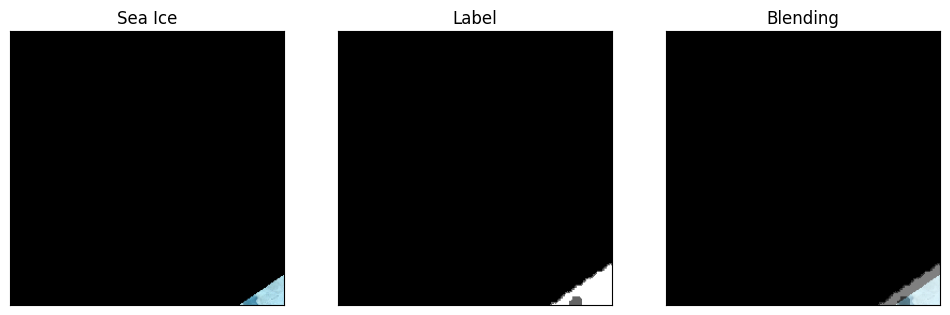

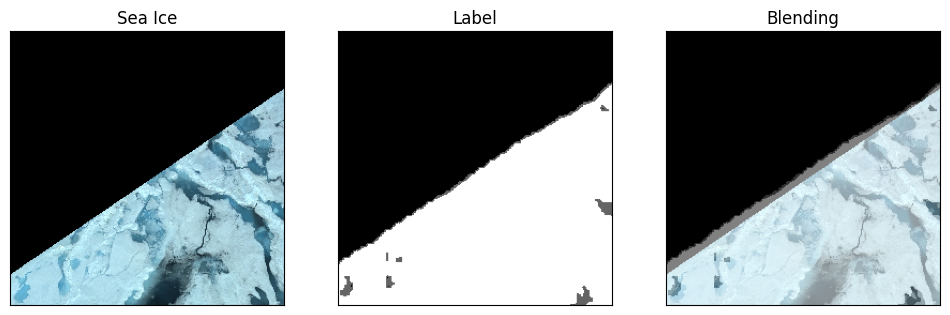

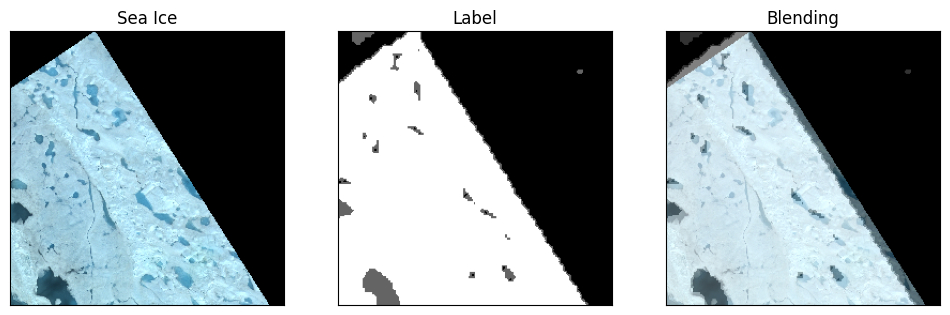

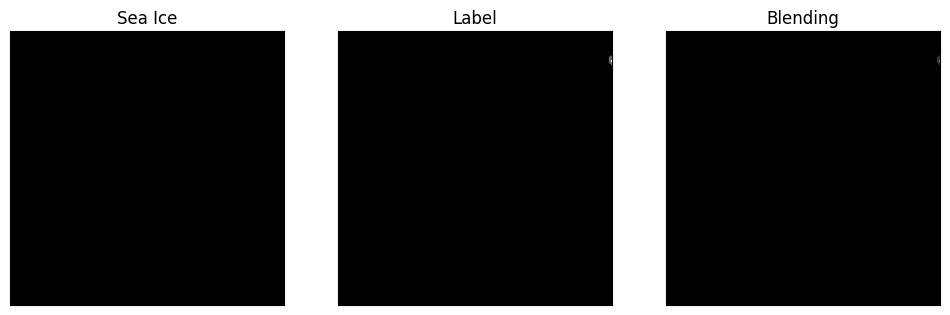

...

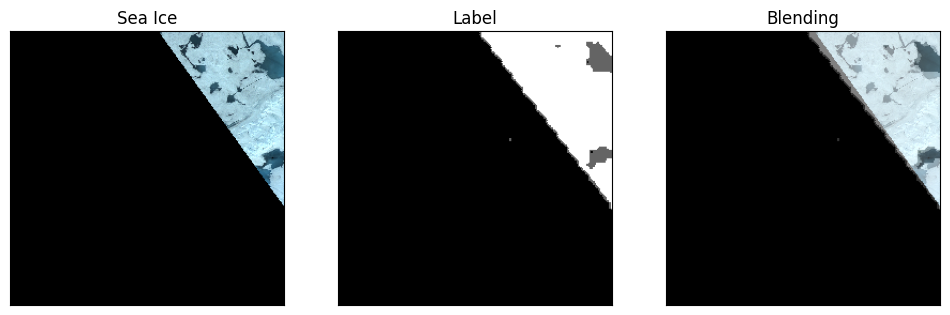

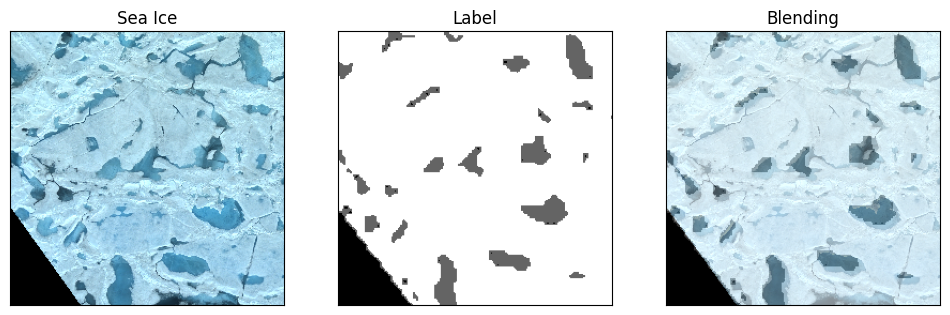

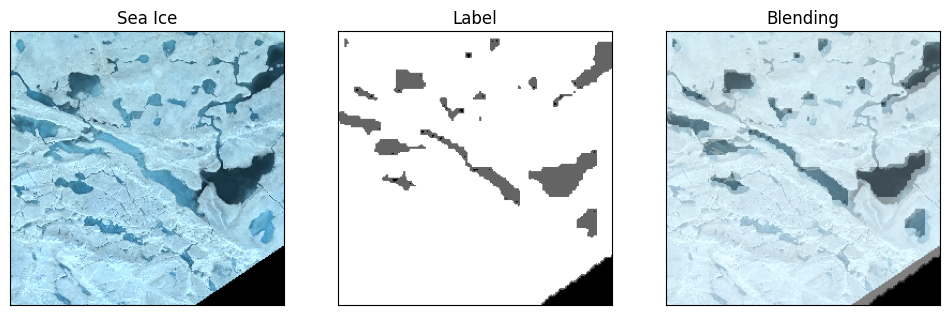

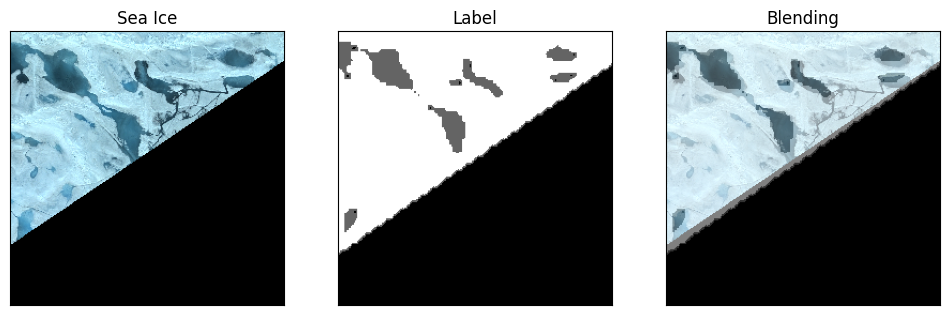

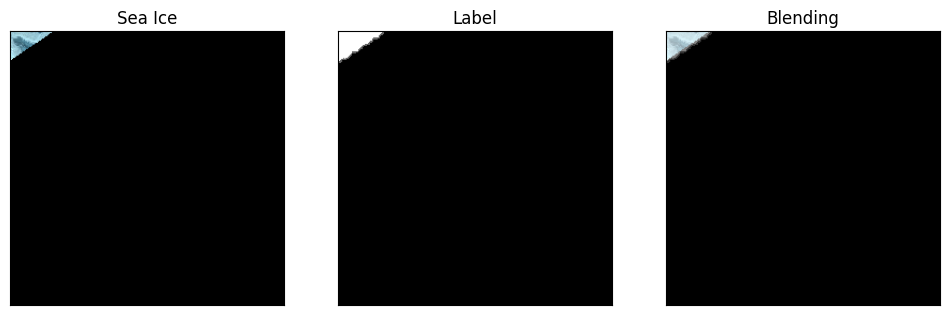

In [140]:
for i in range(len(images)):
  fname = images[i]
  tile = cv2.imread(fname)
  lab = cv2.imread(fname.replace('images', 'labels'))
  plot_images_and_labels(tile, lab)

We use image augmentation to enchance the number of training data we have.

In [141]:
!pip install clodsa

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.4/5.4 MB 72.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 276.2/276.2 kB 37.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for clodsa: filename=clodsa-1.2.48-py2.py3-none-any.whl size=74306 sha256=932722764b487e17d44cadc04b927629e04464e34d37d31bbf27e46b6a5726fc
  Stored in directory: /root/.cache/pip/wheels/57/64/44/4e5198b63c87ac87f1560d7a9625fa1ce34699de407bb2d41c
  Created wheel for commentjson: filename=commentjson-0.9.0-py3-none-any.whl size=12075 sha256=cbae05a36495f91392e4d4c9b16667e2a78f8b6175ca4cca74926923cc259fea
  Stored in directory: /root/.cache/pip/wheels/7d/90/23/6358a234ca5b4ec0866d447079b97fedf9883387d1d7d074e5
  Created wheel for lark-parser: filename=lark_parser-0.7.8-py2.py3-none-any.whl size=625

In [145]:
pip install numpy --upgrade # this needs to be run twice for some reason??? Otherwise next cell won't work.

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [146]:
from clodsa.augmentors.augmentorFactory import createAugmentor
from clodsa.transformers.transformerFactory import transformerGenerator
from clodsa.techniques.techniqueFactory import createTechnique

In [216]:
PROBLEM = "semantic_segmentation"
ANNOTATION_MODE = "folders"
INPUT_PATH = "/content/Tiles/"
GENERATION_MODE = "linear" # all the augmentation techniques are applied to all the images of the original dataset
OUTPUT_MODE = "folders"
OUTPUT_PATH= "/content/augmented_images2/"
LABELS_EXTENSION = ".png"

augmentor = createAugmentor(PROBLEM, ANNOTATION_MODE, OUTPUT_MODE, GENERATION_MODE, INPUT_PATH,{"outputPath":OUTPUT_PATH,"labelsExtension":LABELS_EXTENSION})

In [217]:
transformer = transformerGenerator(PROBLEM) # initialize a transformer

In [218]:
# rotate images
rot90 = createTechnique("rotate", {"angle" : 90})
augmentor.addTransformer(transformer(rot90))
rot180 = createTechnique("rotate", {"angle" : 180})
augmentor.addTransformer(transformer(rot180))
rot270 = createTechnique("rotate", {"angle" : 270})
augmentor.addTransformer(transformer(rot270))

In [219]:
gamma = createTechnique("gamma",{"gamma":1.5})
augmentor.addTransformer(transformer(gamma))

In [220]:
gamma1 = createTechnique("gamma",{"gamma":2.0})
augmentor.addTransformer(transformer(gamma1))

In [221]:
gamma2 = createTechnique("gamma",{"gamma":0.5})
augmentor.addTransformer(transformer(gamma2))

In [222]:
none = createTechnique("none",{}) # need to copy the original images as well!
augmentor.addTransformer(transformer(none))

In [223]:
fliph = createTechnique("flip",{"flip":1})
flipv = createTechnique("flip",{"flip":0})
augmentor.addTransformer(transformer(fliph))
augmentor.addTransformer(transformer(flipv))

In [224]:
# equalize histo
equalize = createTechnique("equalize_histogram", {})
augmentor.addTransformer(transformer(equalize))

In [225]:
salt_and_pepper = createTechnique("salt_and_pepper",{"low":0, 'high': 255})
augmentor.addTransformer(transformer(salt_and_pepper))

In [226]:
median = createTechnique("median_blur",{"kernel":3})
augmentor.addTransformer(transformer(median))

In [227]:
dropout = createTechnique("dropout",{"percentage":0.05})
augmentor.addTransformer(transformer(gamma2))

In [228]:
invert = createTechnique("invert",{})
augmentor.addTransformer(transformer(invert))

In [229]:
len(augmentor.transformers)

14

In [230]:
augmentor.applyAugmentation() # apply the augmentation; this takes a while

In [231]:
images = sorted(glob("/content/augmented_images2/images/*.png"))
labels = sorted(glob("/content/augmented_images2/labels/*.png")) 

In [232]:
len(images)

280

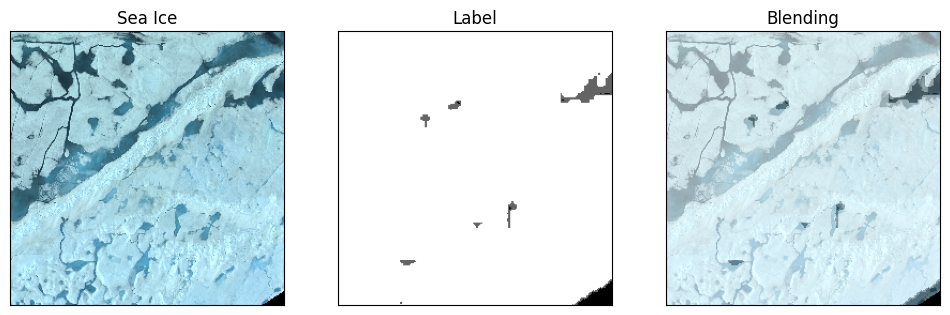

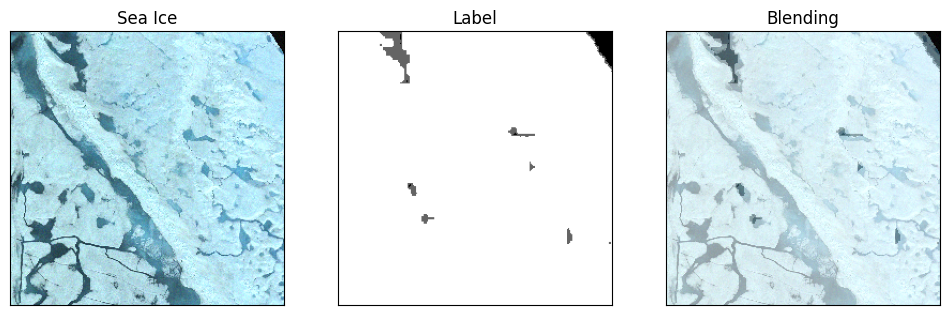

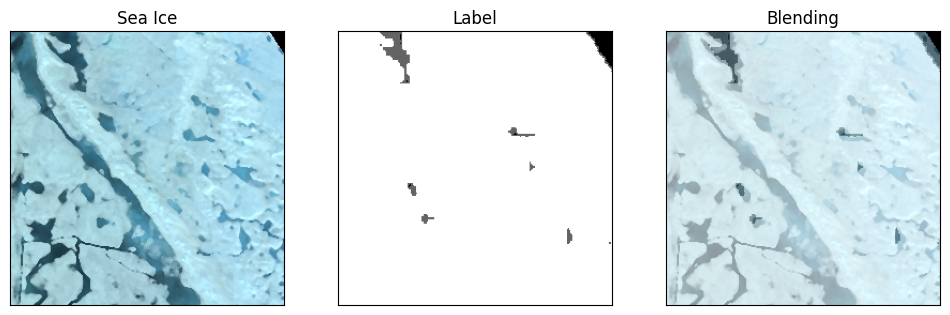

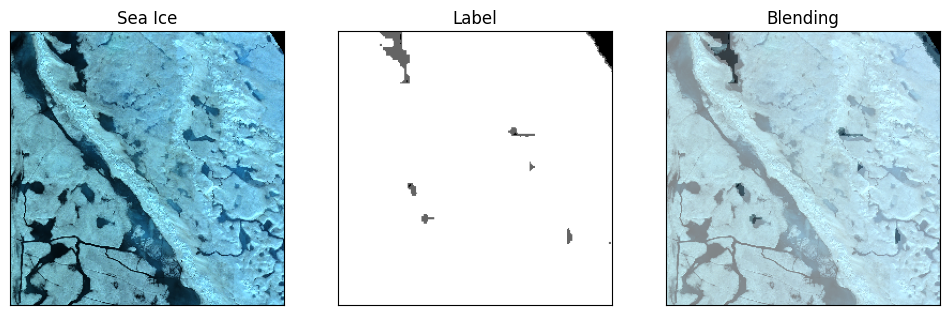

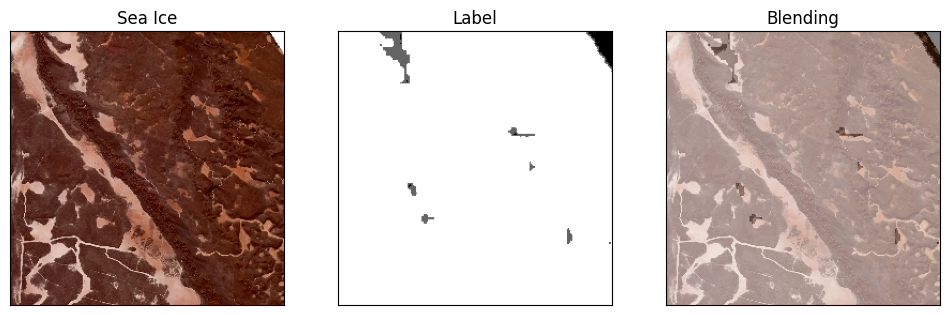

...

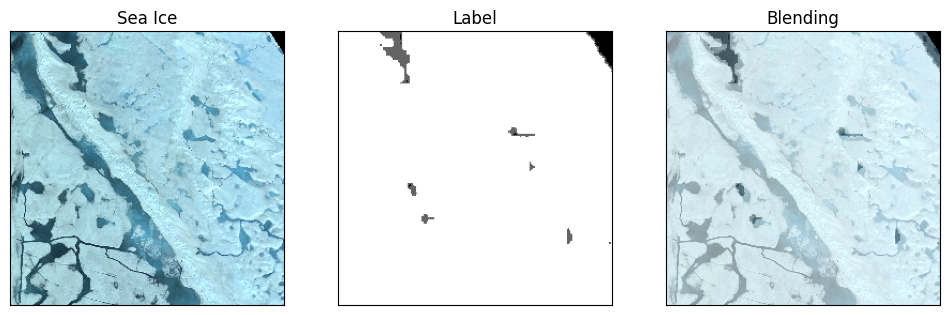

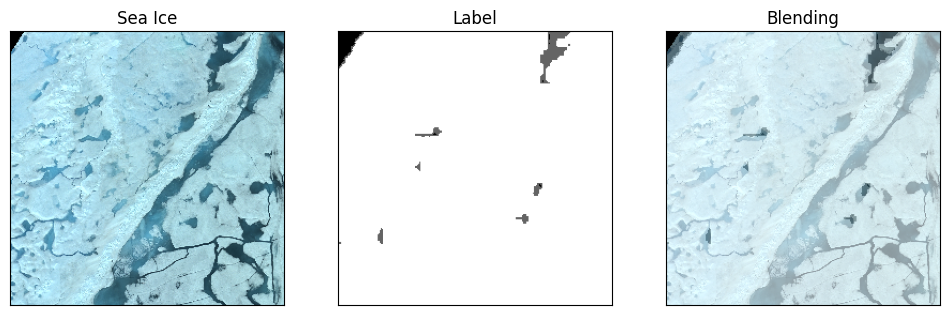

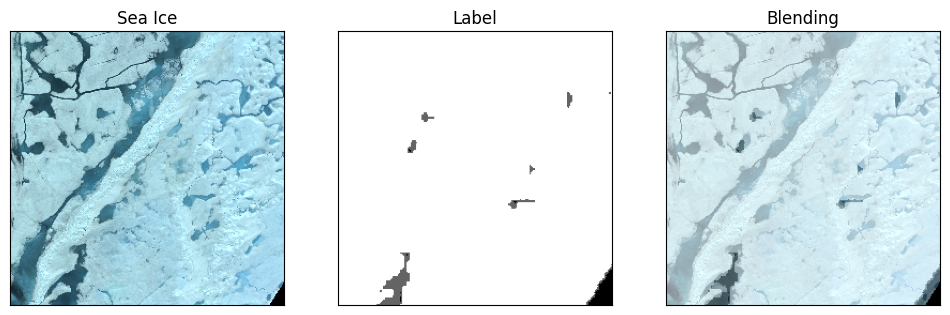

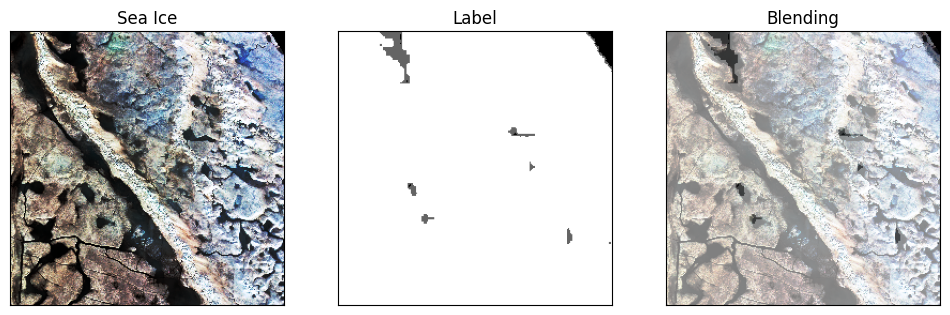

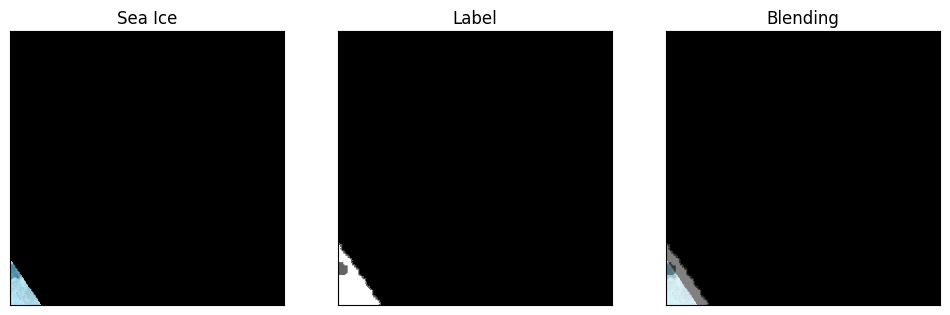

In [233]:
for i in range(15):
  fname = images[i]
  fname2 = labels[i]
  tile = cv2.imread(fname)
  lab = cv2.imread(fname2)
  plot_images_and_labels(tile, lab)

Now we start working on the model.

In [165]:
############### change this ratio
# split 70% into training
train_idx = np.random.choice(np.arange(len(images)), size = int(len(images)*0.7) , replace=False)

# get the rest
idx = np.setdiff1d(np.arange(len(images)), train_idx)

# get val files (20% of total)
val_idx = np.random.choice(idx, size = int(len(images)*0.2) , replace=False)

# get test files (10% of total)
test_idx = np.setdiff1d(val_idx, train_idx)

In [166]:
def image_batch_generator(files, im_size, batch_size = 8):
  
  while True: # this is here because it will be called repeatedly by the training function
    
    # extract a random subset of files of length "batch_size"
    batch = np.random.choice(files, size = batch_size)    
    
    # variables for collecting batches of inputs (x) and outputs (y)
    batch_x = []
    batch_y = []
    
    #cycle through each image in the batch
    for f in batch:
        # open the image and resize
        image = cv2.imread(f) #replaced pillow Image with cv2
        image = image[:,:,:]/255.0 # scale input image to (0, 1)
        # image = np.expand_dims(image,2)
        batch_x.append(image) 

        # open label image by string substitution
        mask = cv2.imread(f.replace('/images/','/labels/')) #replaced pillow Image with cv2
        mask = mask[:,:,0]
        temp = np.zeros((im_size, im_size, 3)) # create expanded target with channels for 3 classes
        temp[:,:,0][mask==0] = 1 # no data
        temp[:,:,1][mask==100] = 1 # ice
        temp[:,:,2][mask==255] = 1 # pond
        mask = temp
        batch_y.append(mask)

    # turn into numpy arrays
    batch_x = np.array(batch_x) 
    batch_y = np.array(batch_y)

    yield (batch_x, batch_y) #yield both the image and the label together

In [167]:
gen = image_batch_generator(images, im_size = 256, batch_size = 8)

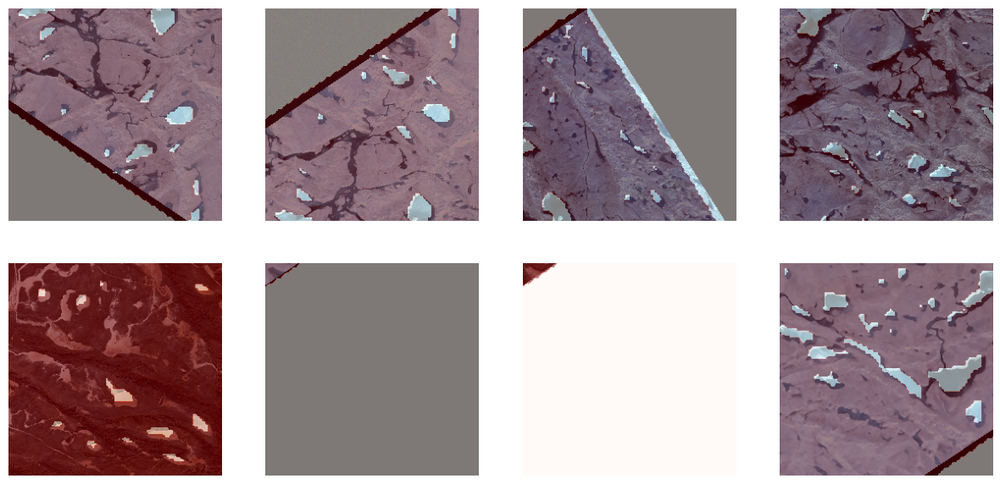

In [168]:
x1, y1 = next(gen)

plt.figure(figsize=(15,15))

counter = 0
for k in range(8):
  plt.subplot(4,4,counter+1)
  plt.imshow(x1[counter])
  plt.imshow(y1[counter][:,:,2], alpha=0.5, cmap=plt.cm.Reds) #adjusted to 2 index to highlight ponds
  plt.axis('off')
  counter += 1

In [169]:
np.shape(x1[0]) # image

(256, 256, 3)

In [170]:
np.shape(y1[0]) # label

(256, 256, 3)

In [171]:
# create arrays of training, validation, and test files (these are filenames)
train_files = np.array(images)[train_idx]
val_files = np.array(images)[val_idx]
test_files = np.array(images)[test_idx]

In [172]:
train_files[:5]

array(['/content/augmented_images2/images/5_1_im003.png',
       '/content/augmented_images2/images/5_6_im003.png',
       '/content/augmented_images2/images/4_10_im010.png',
       '/content/augmented_images2/images/11_8_im013.png',
       '/content/augmented_images2/images/10_0_im001.png'], dtype='<U49')

In [173]:
train_test = plt.imread(train_files[0])
train_test.shape

(256, 256, 3)

In [174]:
val_test = plt.imread(val_files[0])
val_test.shape

(256, 256, 3)

In [175]:
im_size = 256
batch_size = 8

train_generator = image_batch_generator(train_files, im_size, batch_size = batch_size) # call the batch generator for train set
val_generator  = image_batch_generator(val_files, im_size, batch_size = batch_size) # call batch generator validation set

train_steps = len(train_files)//batch_size # number of steps per training epoch
val_steps = len(val_files)//batch_size # number of steps per validation epoch

print(train_steps)
print(val_steps)

24
7


In [176]:
np.unique(y1[2][:,:,1])

array([0., 1.])

In [177]:
y1.shape

(8, 256, 256, 3)

Text(0.5, 1.0, 'Nodata/Background Layer')

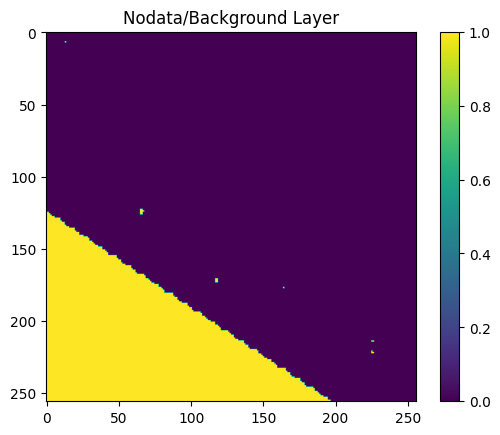

In [178]:
plt.imshow(y1[0, :, :, 0])
plt.colorbar()
plt.title('Nodata/Background Layer')

Text(0.5, 1.0, 'Pond')

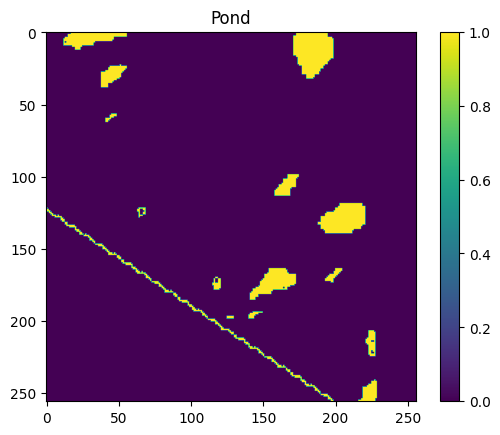

In [180]:
plt.imshow(y1[0, :, :, 1])
plt.colorbar()
plt.title('Pond')

Text(0.5, 1.0, 'Ice')

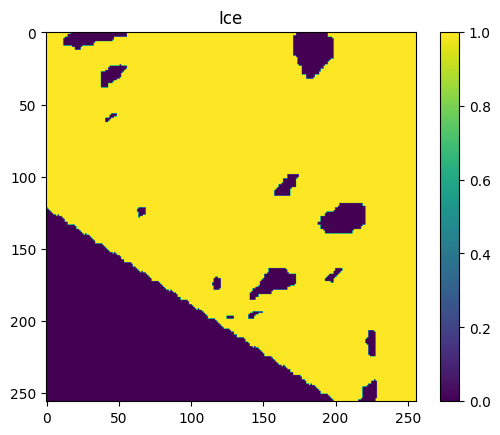

In [182]:
plt.imshow(y1[0, :, :, 2])
plt.colorbar()
plt.title('Ice')

In [183]:
# get an idea about class balance
nodata_fractions = []
pond_fractions = []
nonpond_fractions = []

count = 0

while count < 100:
  x1, y1 = next(gen)
  
  for i in range(8):
    
    nonpond_fraction = len(np.where(y1[i][:,:,1]==1)[0])/(256**2)
    nonpond_fractions.append(nonpond_fraction)

    pond_fraction = len(np.where(y1[i][:,:,2]==1)[0])/(256**2)
    pond_fractions.append(pond_fraction)

    nodata_fractions.append(1 - pond_fraction - nonpond_fraction)
  
  count += 1 

In [184]:
print(1/(3*np.mean(nodata_fractions)), 1/(3*np.mean(nonpond_fractions)),  1/(3*np.mean(pond_fractions)))
# background, pond, non-pond

0.7587367870699377 10.921786097662542 0.6287490077608687


In [186]:
unique, counts = np.unique(grey_mask, return_counts=True)
print('unique: {} | counts: {}'.format(unique, counts))

print('% nodata = {}'.format(100*counts[0]/sum(counts)))
print('% pond = {}'.format(100*counts[1]/sum(counts)))
print('% ice = {}'.format(100*counts[2]/sum(counts)))

unique: [  0 100 255] | counts: [3057008   83545 1478967]
% nodata = 66.17587974508174
% pond = 1.8085212316431145
% ice = 32.01559902327514


In [187]:
#### Calculating weights a different way
import sklearn as sk
from sklearn.utils import class_weight

In [188]:
class_weights = sk.utils.class_weight.compute_class_weight('balanced', classes = np.unique(grey_mask), y = np.ravel(grey_mask))
class_weights

array([ 0.5037082 , 18.43126459,  1.04115913])

In [189]:
def weighted_crossentropy(y_true, y_pred):
    class_weights = tf.constant([[[0.50,  18.43, 1.04]]]) #### this order needs to match y1 label layers index
    unweighted_losses = tf.nn.softmax_cross_entropy_with_logits(labels=y_true, logits=y_pred)
    weights = tf.reduce_sum(class_weights * y_true, axis=-1) # sum of weights
    weighted_losses = weights * unweighted_losses # weighted losses
    loss = tf.reduce_mean(weighted_losses) # mean loss
    return loss

In [190]:
def Unet():
    tf.keras.backend.clear_session()

    image = tf.keras.Input((256,256,3),name='input') #changed to 3 to match rgb image input size

    conv1 = Conv2D(16, (3,3), activation='relu', padding = 'same')(image)
    conv1 = BatchNormalization()(conv1)

    pool1 = MaxPooling2D(pool_size=(2, 2))(conv1)
    conv2 = Conv2D(32, (3,3), activation='relu', padding = 'same')(pool1)
    conv2 = BatchNormalization()(conv2)

    pool2 = MaxPooling2D(pool_size=(2, 2))(conv2)
    conv3 = Conv2D(64, (3,3), activation='relu', padding = 'same')(pool2)
    conv3 = BatchNormalization()(conv3)

    pool3 = MaxPooling2D(pool_size=(2, 2))(conv3)
    conv4 = Conv2D(128, (3,3), activation='relu', padding = 'same')(pool3)
    conv4 = BatchNormalization()(conv4)

    pool4 = MaxPooling2D(pool_size=(2, 2))(conv4)
    conv5 = Conv2D(256, (3,3), activation='relu', padding = 'same')(pool4)
    conv5 = BatchNormalization()(conv5)

    up6 = Conv2DTranspose(128, (3, 3), strides = (2, 2), padding = 'same')(conv5)
    up6 = concatenate([up6, conv4])
    conv6 = Conv2D(128, (3,3), activation='relu', padding = 'same')(up6)
    conv6 = BatchNormalization()(conv6)

    up7 = Conv2DTranspose(64, (3, 3), strides = (2, 2), padding = 'same')(conv6)
    up7 = concatenate([up7, conv3])
    conv7 = Conv2D(64, (3,3), activation='relu', padding = 'same')(up7)
    conv7 = BatchNormalization()(conv7)

    up8 = Conv2DTranspose(32, (3, 3), strides = (2, 2), padding = 'same')(conv7)
    up8 = concatenate([up8, conv2])
    conv8 = Conv2D(32, (3,3), activation='relu', padding = 'same')(up8)
    conv8 = BatchNormalization()(conv8)

    up9 = Conv2DTranspose(16, (3, 3), strides = (2, 2), padding = 'same')(conv8)
    up9 = concatenate([up9, conv1])
    conv9 = Conv2D(16, (3,3), activation='relu', padding = 'same')(up9)
    conv9 = BatchNormalization()(conv9)

    conv10 = Conv2D(3, (1,1), activation='softmax')(conv9)
    model = Model(inputs=[image], outputs=[conv10])

    return model

In [191]:
model = Unet()
loss = weighted_crossentropy
model.compile(optimizer=Adam(), loss=loss, metrics=["accuracy"])

In [192]:
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input (InputLayer)             [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d (Conv2D)                (None, 256, 256, 16  448         ['input[0][0]']                  
                                )                                                                 
                                                                                                  
 batch_normalization (BatchNorm  (None, 256, 256, 16  64         ['conv2d[0][0]']                 
 alization)                     )                                                             

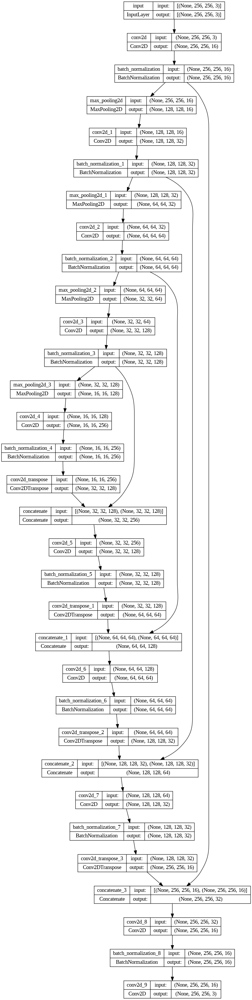

In [193]:
from keras.utils import plot_model
plot_model(model,show_shapes=True)

In [194]:
callbacks = [
    EarlyStopping(patience=5, verbose=1),
    ReduceLROnPlateau(factor=0.1, patience=5, min_lr=0.00001, verbose=1),
    ModelCheckpoint('model_1.h5', verbose=1, save_best_only=True, save_weights_only=True)
]

In [195]:
results = model.fit(train_generator, 
                epochs = 100, steps_per_epoch = train_steps,
                validation_data = val_generator, validation_steps = val_steps,
                callbacks = callbacks)	

Epoch 1/100
24/24 [==============================] - ETA: 0s - loss: 1.1078 - accuracy: 0.7296
Epoch 1: val_loss improved from inf to 1.35308, saving model to model_1.h5
24/24 [==============================] - 21s 92ms/step - loss: 1.1078 - accuracy: 0.7296 - val_loss: 1.3531 - val_accuracy: 0.5923 - lr: 0.0010
Epoch 2/100
24/24 [==============================] - ETA: 0s - loss: 0.9602 - accuracy: 0.8332
Epoch 2: val_loss did not improve from 1.35308
24/24 [==============================] - 2s 79ms/step - loss: 0.9602 - accuracy: 0.8332 - val_loss: 1.4197 - val_accuracy: 0.4934 - lr: 0.0010
Epoch 3/100
24/24 [==============================] - ETA: 0s - loss: 0.9615 - accuracy: 0.8127
Epoch 3: val_loss did not improve from 1.35308
24/24 [==============================] - 2s 99ms/step - loss: 0.9615 - accuracy: 0.8127 - val_loss: 1.3668 - val_accuracy: 0.6292 - lr: 0.0010
Epoch 4/100
24/24 [==============================] - ETA: 0s - loss: 0.8928 - accuracy: 0.8620
Epoch 4: val_loss did

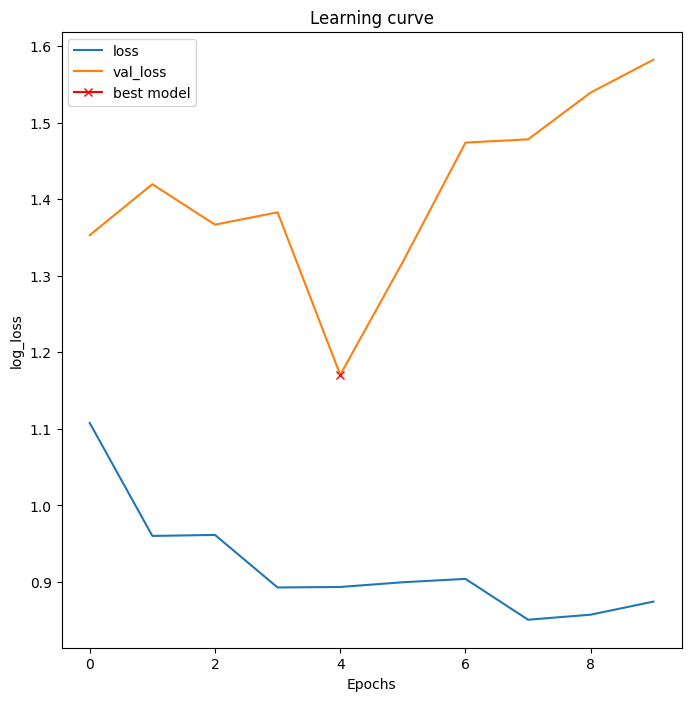

In [196]:
# with batch normalization
plt.figure(figsize=(8, 8))
plt.title("Learning curve")
plt.plot(results.history["loss"], label="loss")
plt.plot(results.history["val_loss"], label="val_loss")
plt.plot(np.argmin(results.history["val_loss"]), np.min(results.history["val_loss"]), marker="x", color="r", label="best model")
plt.xlabel("Epochs")
plt.ylabel("log_loss")
plt.legend();

In [197]:
# load the best model
model=Unet()
model.load_weights('model_1.h5')
loss = weighted_crossentropy
model.compile(optimizer=Adam(), loss=loss, metrics=["accuracy"])

In [198]:
test_generator = image_batch_generator(test_files, im_size, batch_size = batch_size)
print("# test files: %i" % (len(test_files)))
# some other training parameters
steps = len(test_files) // batch_size
# testing
scores = model.evaluate(test_generator, steps=steps) 

# test files: 56
7/7 [==============================] - 1s 51ms/step - loss: 1.1796 - accuracy: 0.8738


In [199]:
print(model.metrics_names)
print(scores)

['loss', 'accuracy']
[1.1796119213104248, 0.8738051652908325]


We can see that our training accuracy is higher than our test and validation accuracies, indicating some possible overfitting. We can try to fix this by adding dropout layers in the Unet model.

In [200]:
def Unet_dropout():
    tf.keras.backend.clear_session()

    image = tf.keras.Input((256,256,3),name='input')

    conv1 = Conv2D(16, (3,3), activation='relu', padding = 'same')(image)
    conv1 = BatchNormalization()(conv1)

    pool1 = MaxPooling2D(pool_size=(2, 2))(conv1)
    pool1 = Dropout(0.25)(pool1) ### added dropout
    conv2 = Conv2D(32, (3,3), activation='relu', padding = 'same')(pool1)
    conv2 = BatchNormalization()(conv2)

    pool2 = MaxPooling2D(pool_size=(2, 2))(conv2)
    pool2 = Dropout(0.5)(pool2) ### added dropout
    conv3 = Conv2D(64, (3,3), activation='relu', padding = 'same')(pool2)
    conv3 = BatchNormalization()(conv3)

    pool3 = MaxPooling2D(pool_size=(2, 2))(conv3)
    pool3 = Dropout(0.5)(pool3) ### added dropout
    conv4 = Conv2D(128, (3,3), activation='relu', padding = 'same')(pool3)
    conv4 = BatchNormalization()(conv4)

    pool4 = MaxPooling2D(pool_size=(2, 2))(conv4)
    pool4 = Dropout(0.5)(pool4) ### added dropout
    conv5 = Conv2D(256, (3,3), activation='relu', padding = 'same')(pool4)
    conv5 = BatchNormalization()(conv5)

    up6 = Conv2DTranspose(128, (3, 3), strides = (2, 2), padding = 'same')(conv5)
    up6 = concatenate([up6, conv4])
    up6 = Dropout(0.5)(up6)
    conv6 = Conv2D(128, (3,3), activation='relu', padding = 'same')(up6)
    conv6 = BatchNormalization()(conv6)

    up7 = Conv2DTranspose(64, (3, 3), strides = (2, 2), padding = 'same')(conv6)
    up7 = concatenate([up7, conv3])
    up7 = Dropout(0.5)(up7)
    conv7 = Conv2D(64, (3,3), activation='relu', padding = 'same')(up7)
    conv7 = BatchNormalization()(conv7)

    up8 = Conv2DTranspose(32, (3, 3), strides = (2, 2), padding = 'same')(conv7)
    up8 = concatenate([up8, conv2])
    up8 = Dropout(0.5)(up8)
    conv8 = Conv2D(32, (3,3), activation='relu', padding = 'same')(up8)
    conv8 = BatchNormalization()(conv8)

    up9 = Conv2DTranspose(16, (3, 3), strides = (2, 2), padding = 'same')(conv8)
    up9 = concatenate([up9, conv1])
    up9 = Dropout(0.5)(up9)
    conv9 = Conv2D(16, (3,3), activation='relu', padding = 'same')(up9)
    conv9 = BatchNormalization()(conv9)

    conv10 = Conv2D(3, (1,1), activation='softmax')(conv9)
    model = Model(inputs=[image], outputs=[conv10])

    return model

In [201]:
model2 = Unet_dropout()
loss = weighted_crossentropy
model2.compile(optimizer=Adam(), loss=loss, metrics=["accuracy"])

In [202]:
model2.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input (InputLayer)             [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d (Conv2D)                (None, 256, 256, 16  448         ['input[0][0]']                  
                                )                                                                 
                                                                                                  
 batch_normalization (BatchNorm  (None, 256, 256, 16  64         ['conv2d[0][0]']                 
 alization)                     )                                                             

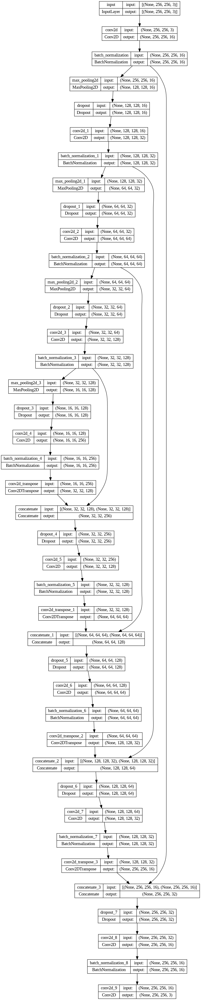

In [203]:
plot_model(model2,show_shapes=True)

In [204]:
callbacks = [
    EarlyStopping(patience=5, verbose=1),
    ReduceLROnPlateau(factor=0.1, patience=5, min_lr=0.00001, verbose=1),
    ModelCheckpoint('model_1.h5', verbose=1, save_best_only=True, save_weights_only=True)
]

In [205]:
results2 = model2.fit(train_generator, 
                epochs = 100, steps_per_epoch = train_steps,
                validation_data = val_generator, validation_steps = val_steps,
                callbacks = callbacks)	

Epoch 1/100
24/24 [==============================] - ETA: 0s - loss: 1.1813 - accuracy: 0.6839
Epoch 1: val_loss improved from inf to 1.55237, saving model to model_1.h5
24/24 [==============================] - 13s 133ms/step - loss: 1.1813 - accuracy: 0.6839 - val_loss: 1.5524 - val_accuracy: 0.8160 - lr: 0.0010
Epoch 2/100
24/24 [==============================] - ETA: 0s - loss: 1.0586 - accuracy: 0.7765
Epoch 2: val_loss improved from 1.55237 to 1.46261, saving model to model_1.h5
24/24 [==============================] - 2s 99ms/step - loss: 1.0586 - accuracy: 0.7765 - val_loss: 1.4626 - val_accuracy: 0.4584 - lr: 0.0010
Epoch 3/100
24/24 [==============================] - ETA: 0s - loss: 1.0124 - accuracy: 0.8211
Epoch 3: val_loss improved from 1.46261 to 1.43509, saving model to model_1.h5
24/24 [==============================] - 3s 110ms/step - loss: 1.0124 - accuracy: 0.8211 - val_loss: 1.4351 - val_accuracy: 0.5273 - lr: 0.0010
Epoch 4/100
24/24 [==============================]

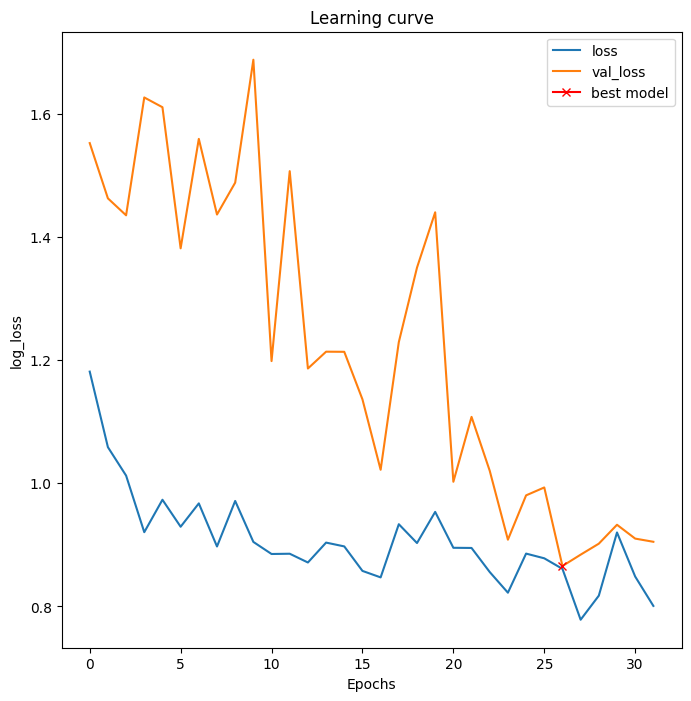

In [206]:
# with batch normalization and dropout
plt.figure(figsize=(8, 8))
plt.title("Learning curve")
plt.plot(results2.history["loss"], label="loss")
plt.plot(results2.history["val_loss"], label="val_loss")
plt.plot(np.argmin(results2.history["val_loss"]), np.min(results2.history["val_loss"]), marker="x", color="r", label="best model")
plt.xlabel("Epochs")
plt.ylabel("log_loss")
plt.legend();

In [207]:
# load the best model
model2=Unet()
model2.load_weights('model_1.h5')
loss = weighted_crossentropy
model2.compile(optimizer=Adam(), loss=loss, metrics=["accuracy"])

In [208]:
test_generator = image_batch_generator(test_files, im_size, batch_size = batch_size)
print("# test files: %i" % (len(test_files)))
# some other training parameters
steps = len(test_files) // batch_size
# testing
scores = model2.evaluate(test_generator, steps=steps) 

# test files: 56
7/7 [==============================] - 1s 50ms/step - loss: 0.8459 - accuracy: 0.8479


In [209]:
print(model2.metrics_names)
print(scores)

['loss', 'accuracy']
[0.8458784818649292, 0.8479442596435547]


By adding dropout layers, we improved the overall model accuracy, however, our loss curve is still suspicious and indicates that the model is overfitting.

We can now plot the predicted labels against the image data. We start with a tile selection from the training data.

In [210]:
from skimage.measure import regionprops, regionprops_table
from skimage.morphology import binary_dilation, binary_erosion
from shapely.geometry import Polygon, LineString
from shapely.affinity import scale
from descartes import PolygonPatch
from skimage.morphology import reconstruction
import scipy.ndimage as ndi
from skimage import measure
from skimage.segmentation import watershed
from shapely.geometry import Polygon
import scipy.interpolate
import math
from matplotlib.colors import ListedColormap


#  functions for assembling big image from prediction tiles:
def predict_image_tile(im_tile, model):
    if len(np.shape(im_tile)) == 2:
      im_tile = np.expand_dims(im_tile, axis = 2) # add dimension for channel
    
    im_tile = np.expand_dims(im_tile, axis = 0) # add dimension for batch
    
    return model.predict(im_tile, verbose=0)[0]

def predict_big_image(big_im, model, I):
    pad_rows = I - np.mod(big_im.shape[0], I)
    pad_cols = I - np.mod(big_im.shape[1], I)
    
    if len(np.shape(big_im)) == 2:
      big_im = np.vstack((big_im, np.zeros((pad_rows, big_im.shape[1]))))
      big_im = np.hstack((big_im, np.zeros((big_im.shape[0], pad_cols))))
   
    if len(np.shape(big_im)) == 3:
      big_im = np.vstack((big_im, np.zeros((pad_rows, big_im.shape[1], big_im.shape[2]))))
      big_im = np.hstack((big_im, np.zeros((big_im.shape[0], pad_cols, big_im.shape[2]))))
    
    r = int(np.floor(big_im.shape[0]/I)) # number of rows of image tiles
    c = int(np.floor(big_im.shape[1]/I)) # number of columns of image tiles

    I2 = int(I/2)
    W = np.hanning(I) * np.hanning(I)[:, np.newaxis]
    Wup = W.copy()
    Wup[:I2, :] = np.tile(np.hanning(I), (I2, 1))
    Wdown = W.copy()
    Wdown[I2:, :] = np.tile(np.hanning(I), (I2, 1))

    if len(np.shape(big_im)) == 2:
      big_im = np.hstack((np.zeros((r*I, I2)), big_im, np.zeros((r*I, I2)))) # padding on the left and right sides
   
    if len(np.shape(big_im)) == 3:
      big_im = np.hstack((np.zeros((r*I, I2, 3)), big_im, np.zeros((r*I, I2, 3)))) # padding on the left and right sides
    
    big_im_pred = np.zeros((big_im.shape[0], big_im.shape[1], 3))

    for i in trange(c+1): # rows, no offset
      for j in range(1,2*r-2): # columns
        im_tile = big_im[j*I2:(j+2)*I2, i*I:(i+1)*I]/255.0
        im_tile_pred = predict_image_tile(im_tile, model)

        for layer in range(3):
          big_im_pred[j*I2:(j+2)*I2, i*I:(i+1)*I, layer] += im_tile_pred[:, :, layer] * W
    
    for i in range(c+1): # first row
      im_tile = big_im[:2*I2, i*I:(i+1)*I]/255.0
      im_tile_pred = predict_image_tile(im_tile, model)

      for layer in range(3):
        big_im_pred[:2*I2, i*I:(i+1)*I, layer] += im_tile_pred[:, :, layer] * Wup
    
    for i in range(c+1): # last row
      im_tile = big_im[(2*r-2)*I2:2*r*I2, i*I:(i+1)*I]/255.0
      im_tile_pred = predict_image_tile(im_tile,model)

      for layer in range(3):
        big_im_pred[(2*r-2)*I2:2*r*I2, i*I:(i+1)*I, layer] += im_tile_pred[:, :, layer] * Wdown

    for i in trange(c): # rows, half offset
      for j in range(1,2*r-2): # columns
        im_tile = big_im[j*I2:(j+2)*I2, i*I+I2:(i+1)*I+I2]/255.0
        im_tile_pred = predict_image_tile(im_tile,model)

        for layer in range(3):
          big_im_pred[j*I2:(j+2)*I2, i*I+I2:(i+1)*I+I2, layer] += im_tile_pred[:, :, layer] * W
    
    for i in range(c): # first row
      im_tile = big_im[:2*I2, i*I+I2:(i+1)*I+I2]/255.0
      im_tile_pred = predict_image_tile(im_tile,model)

      for layer in range(3):
        big_im_pred[:2*I2, i*I+I2:(i+1)*I+I2, layer] += im_tile_pred[:, :, layer] * Wup
    
    for i in range(c): # last row
      im_tile = big_im[(2*r-2)*I2:2*r*I2, i*I+I2:(i+1)*I+I2]/255.0
      im_tile_pred = predict_image_tile(im_tile,model)

      for layer in range(3):
        big_im_pred[(2*r-2)*I2:2*r*I2, i*I+I2:(i+1)*I+I2, layer] += im_tile_pred[:, :, layer] * Wdown

    big_im_pred = big_im_pred[:, I2:-I2, :] # crop the left and right side padding
    big_im_pred = big_im_pred[:-pad_rows, :-pad_cols, :] # get rid of padding
    
    return big_im_pred

[]

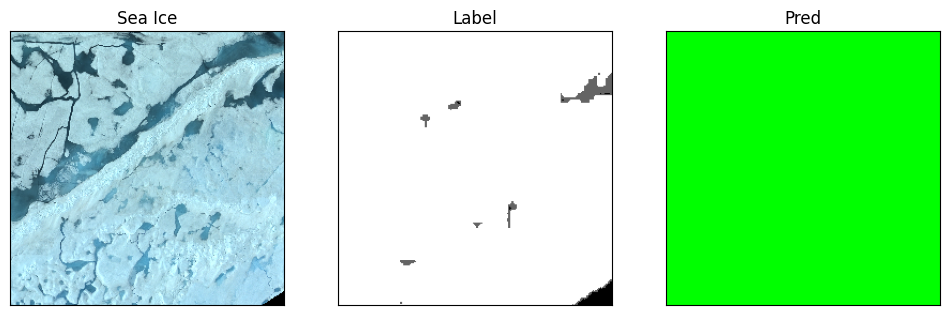

In [211]:
tile = cv2.imread(images[0])
lab = cv2.imread(labels[0])
pred = predict_image_tile(tile, model2)

fig = plt.figure(figsize = (12, 4))
  
ax1 = fig.add_subplot(131)
ax1.imshow(tile[:,:])
ax1.set_title("Sea Ice")
ax1.set_xticks([])
ax1.set_yticks([])

ax2 = fig.add_subplot(132)
ax2.imshow(lab[:,:])
ax2.set_title("Label")
ax2.set_xticks([])
ax2.set_yticks([])

ax3 = fig.add_subplot(133)
ax3.imshow(pred[:,:])
ax3.set_title("Pred")
ax3.set_xticks([])
ax3.set_yticks([])



We can see that the prediction fails to identify the ponds, and instead covers labels the entire ice sheet as "nonpond" (green color). To verify, we also plot the large image.

In [212]:
p10_168_pred = predict_big_image(img[:,:,0:3], model2, I=256)

100%|██████████| 6/6 [00:03<00:00,  1.78it/s]


In [213]:
uni_pred, count_pred = np.unique(p10_168_pred, return_counts=True)
print(uni_pred, count_pred)

[3.98207063e-14 9.98580521e-14 1.24275671e-13 ... 9.99961578e-01
 9.99961936e-01 9.99962055e-01] [1 1 1 ... 1 3 3]


Text(0.5, 1.0, 'Probability of pond label')

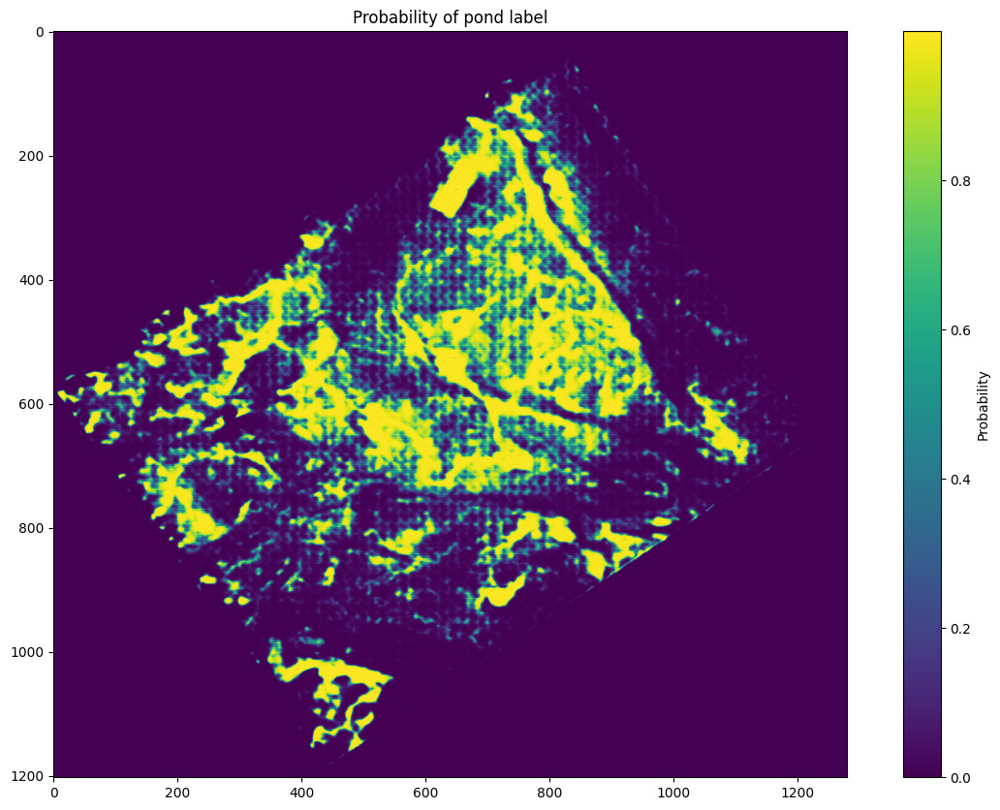

In [214]:
plt.figure(figsize=(15,10))
plt.imshow(p10_168_pred[:, :, 2])
plt.colorbar(label='Probability')
plt.title('Probability of pond label')

Again, the model fails to predict ponds. This is a large indication that our model does not have enough pond data to accurately predict them from the other label classes and that our model is overfitted relative to the nonpond and nodata (background) labels. To improve this, more data for ponds would be necessary to improve the model training. 